
# San Francisco and Seattle - Car Prowl tops all crime categories by a large margin in Summer 2014


** Car Prowl ** is the act of stealing valuables from the car. The exploration of San Francisco's and Seattle's crime incidents over Summer 2014 leads us to the discovery of the extensiveness of these car prowl incidents across the city. Please jump to [Hypothesis and supporting analysis](#hyp) section for the supporting visualizations.

** Python Libraries used ** - Pandas, Seaborn and Folium

### Table of Contents
1. [Exploration](#exp)  
  1.a. [San Francisco](#sfo)  
  1.b. [Seattle](#stl)  
  1.c. [San Francisco vs. Seattle](#sfo_stl)
2. [Hypothesis and supporting analysis](#hyp)
3. [Conclusion](#con)


## 1. Exploration <a class="anchor" id="exp"></a>

In [1]:
# Import all necessary packages
import pandas as pd

from matplotlib import pyplot as plt
import seaborn as sns
import folium as flm

import calendar

%matplotlib inline

Let's take a look at San Francisco and Seattle data sets, one at a time first. After observing each individually, we'll compare both the datasets side by side.

Moving on to San Francisco data set -

## 1.1. San Francisco <a class="anchor" id="sfo"></a>

In [2]:
# Load dataset and take a quick preview
sfo = pd.read_csv('sanfrancisco_incidents_summer_2014.csv')
sfo.head()

,IncidntNum,Category,Descript,DayOfWeek,Date,Time,PdDistrict,Resolution,Address,X,Y,Location,PdId
0,140734311,ARSON,ARSON OF A VEHICLE,Sunday,08/31/2014,23:50,BAYVIEW,NONE,LOOMIS ST / INDUSTRIAL ST,-122.405647,37.738322,"(37.7383221869053, -122.405646994567)",14073431126031
1,140736317,NON-CRIMINAL,LOST PROPERTY,Sunday,08/31/2014,23:45,MISSION,NONE,400 Block of CASTRO ST,-122.435012,37.761768,"(37.7617677182954, -122.435012093789)",14073631771000
2,146177923,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Sunday,08/31/2014,23:30,SOUTHERN,NONE,1000 Block of MISSION ST,-122.409795,37.780036,"(37.7800356268394, -122.409795194505)",14617792306244
3,146177531,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Sunday,08/31/2014,23:30,RICHMOND,NONE,FULTON ST / 26TH AV,-122.485263,37.772518,"(37.7725176473142, -122.485262988324)",14617753106244
4,140734220,NON-CRIMINAL,FOUND PROPERTY,Sunday,08/31/2014,23:23,RICHMOND,NONE,800 Block of LA PLAYA ST,-122.509895,37.772313,"(37.7723131976814, -122.509895418239)",14073422072000


In [3]:
# Organize and rename the columns/ data labels, 
# Drop the columns that may not be useful and add any derived columns as needed
sfo=sfo.drop(['Address','Location','PdId'],axis=1)
sfo.columns=['inc_no','category','desc','day','date','time','district','resolution','long','lat']
sfo['time_hr'] = sfo['time'].str[:2]
sfo['date'] = pd.to_datetime(sfo['date'])
sfo['week'] = sfo['date'].dt.weekofyear
sfo['month'] = (sfo['date'].dt.month).apply(lambda x: calendar.month_abbr[x])

sfo.head()

,inc_no,category,desc,day,date,time,district,resolution,long,lat,time_hr,week,month
0,140734311,ARSON,ARSON OF A VEHICLE,Sunday,2014-08-31,23:50,BAYVIEW,NONE,-122.405647,37.738322,23,35,Aug
1,140736317,NON-CRIMINAL,LOST PROPERTY,Sunday,2014-08-31,23:45,MISSION,NONE,-122.435012,37.761768,23,35,Aug
2,146177923,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Sunday,2014-08-31,23:30,SOUTHERN,NONE,-122.409795,37.780036,23,35,Aug
3,146177531,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Sunday,2014-08-31,23:30,RICHMOND,NONE,-122.485263,37.772518,23,35,Aug
4,140734220,NON-CRIMINAL,FOUND PROPERTY,Sunday,2014-08-31,23:23,RICHMOND,NONE,-122.509895,37.772313,23,35,Aug


Let's plot all the incidents on the San Francisco map using the lat, long values. 

_Throughout this exercise, all the city, district and zone coordinates are derived using the corresponding mean values of lat and long from the dataset, rather than their true coordinates from external sources. It was an experimental attempt in case we don't have access to the true values and it worked out fine. Simpler in fact, as opposed to hard coding all the values into our dataset._

_I have used the python library **Folium** for all the map charts in this exercise._

In [4]:
sfo_map_1=flm.Map(location=[sfo['lat'].mean(), sfo['long'].mean()],
                  zoom_start=12, min_zoom=12)


sfo_by_loc = sfo.groupby(['lat','long'], as_index='False')
sfo_loc_stats = sfo_by_loc['inc_no'].count()
sfo_loc_stats = sfo_loc_stats.reset_index()
sfo_loc_stats

for index,row in sfo_loc_stats.iterrows():
    lat,lng,count = row['lat'],row['long'], row['inc_no']
    flm.CircleMarker(
        [lat,lng],
        radius=count*0.01,
        popup="(" + str(lat) + "," + str(lng) + ") : " + str(int(count)) + " incidents",
        color='#DF0804',
        fill_color='#DF0804'
    ).add_to(sfo_map_1)
    

# Plotting this map takes around 5 minutes.
sfo_map_1

**_Click on the map markers for details._**

Now, let's plot the incidents count consolidated for each districts.

In [5]:
sfo_map_2=flm.Map(location=[sfo['lat'].mean(), sfo['long'].mean()],
                  zoom_start=12,min_zoom=12)

sfo_by_district = sfo.groupby('district', as_index='False')
sfo_district_stats = sfo_by_district[['lat','long']].mean()
sfo_district_stats['count'] = sfo_by_district['district'].count()
sfo_district_stats = sfo_district_stats.reset_index()

for index,row in sfo_district_stats.iterrows():
    dist,lat,lng,count = row['district'], row['lat'],row['long'], row['count']
    flm.CircleMarker(
        [lat,lng],
        radius=count*0.004,
        popup=dist.title() + " District: " + str(count) + ' incidents',
        color='#C12515',
        fill_color='#C12515'
    ).add_to(sfo_map_2)

sfo_map_2

**_Click on the map markers for details_**

Plotting a jointplot for long and lat columns also produces a rough map plot, without any map utilities. The below chart is similar to the ones presented above, without the map layer underneath.

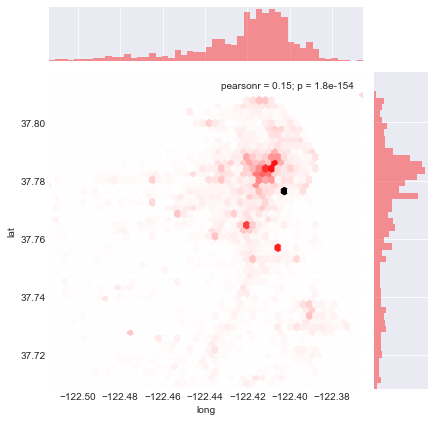

In [6]:
sns.set_style("darkgrid")
sns.jointplot(data=sfo,x='long',y='lat',kind='hex',color='red')

In [7]:
# Few constants - To be used through out this exercise
DAYS_OF_WEEK = ["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"]
SUMMER_MONTHS = ['Jun','Jul','Aug']

Let's plot the monthly counts and the spread over the days of the week.

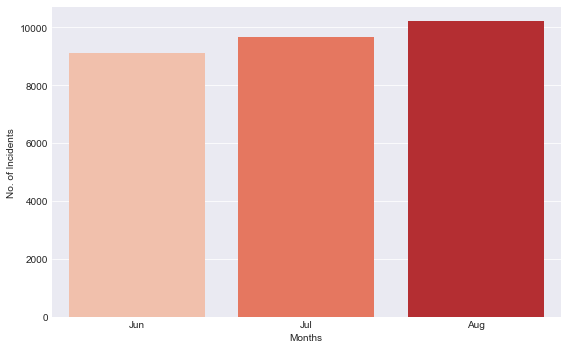

In [8]:
plt.figure(figsize=(8,5))
sns.countplot(data=sfo, x='month', order = SUMMER_MONTHS, palette='Reds')
plt.xlabel("Months")
plt.ylabel("No. of Incidents")
plt.tight_layout()

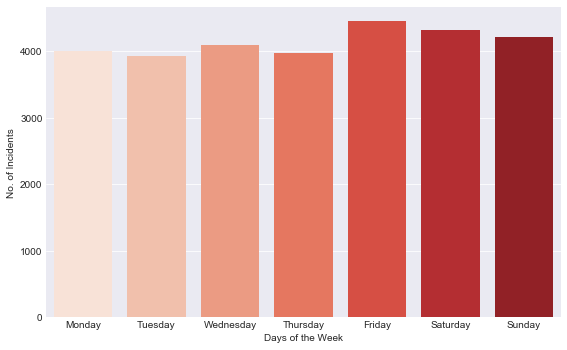

In [9]:
plt.figure(figsize=(8,5))
sns.countplot(data=sfo, x='day', order = DAYS_OF_WEEK, palette='Reds')
plt.xlabel("Days of the Week")
plt.ylabel("No. of Incidents")
plt.tight_layout()

We see an upward trend in month over month, and high counts on the weekends (Friday to Sunday).

Now, let's plot a heatmap to observe the incidents across Day of the week and Time of the day

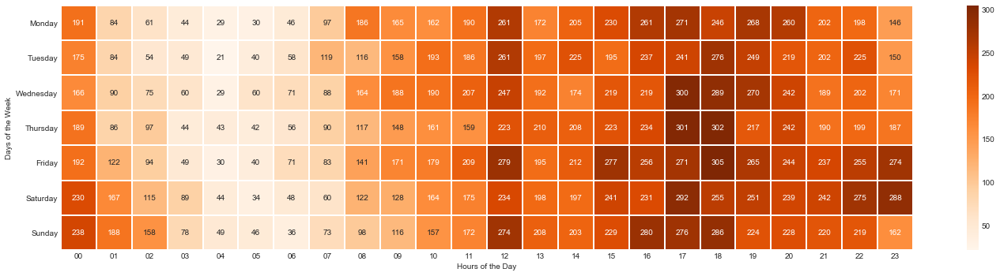

In [10]:
sfo_day_time_df=sfo[['day','time_hr']].copy()
sfo_day_time_df['count'] = 1
sfo_day_time_grp = sfo_day_time_df.groupby(['day','time_hr']).count()

sfo_day_time_grp = sfo_day_time_grp.reset_index()

sfo_day_time_grp['day'] = pd.Categorical(sfo_day_time_grp['day'],DAYS_OF_WEEK)

plt.figure(figsize=(20,5))
sns.heatmap(sfo_day_time_grp.pivot('day','time_hr','count'), cmap='Oranges',
            annot=True, fmt='d',linecolor='white',linewidth='1')
plt.xlabel("Hours of the Day")
plt.ylabel("Days of the Week")
plt.tight_layout()

We see a high crime trend towards weekends, and also daily peak values around 5PM - 7PM window.

Next, let's plot a cluster plot to compare the incident categories across the districts.

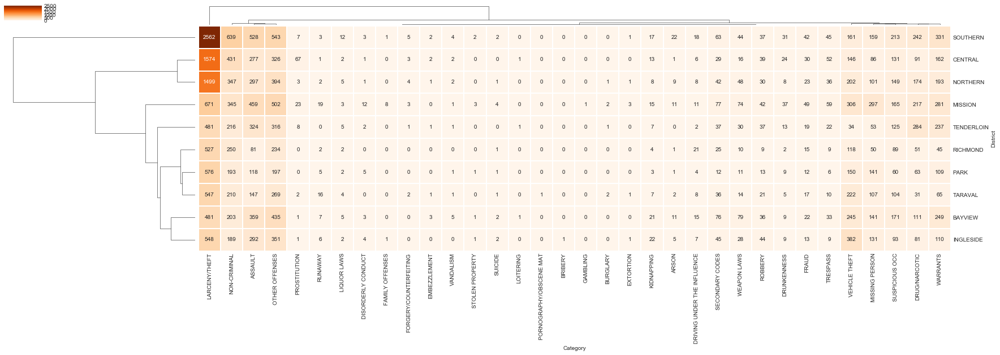

In [11]:
sfo_dist_cat_df=sfo[['district','category']].copy()
sfo_dist_cat_df['count'] = 1
sfo_dist_cat_grp = sfo_dist_cat_df.groupby(['district','category']).count()

sfo_dist_cat_grp = sfo_dist_cat_grp.reset_index()

sfo_dist_cat_pvt = sfo_dist_cat_grp.pivot('district','category','count').fillna(0).astype(int)

g = sns.clustermap(sfo_dist_cat_pvt,figsize=(30,8),cmap='Oranges',
               linewidth='1',linecolor='white',annot=True, fmt='d')
g.ax_heatmap.set_xlabel("Category")
g.ax_heatmap.set_ylabel("District")

We see that 'Southern','Central' and 'Northern' districts tops in the crime incidents. Also, 'Larceny/ Theft' appears to be the most common type of crime across all the districts.

Now, let's see how these different crime categories are distributed throughout the day

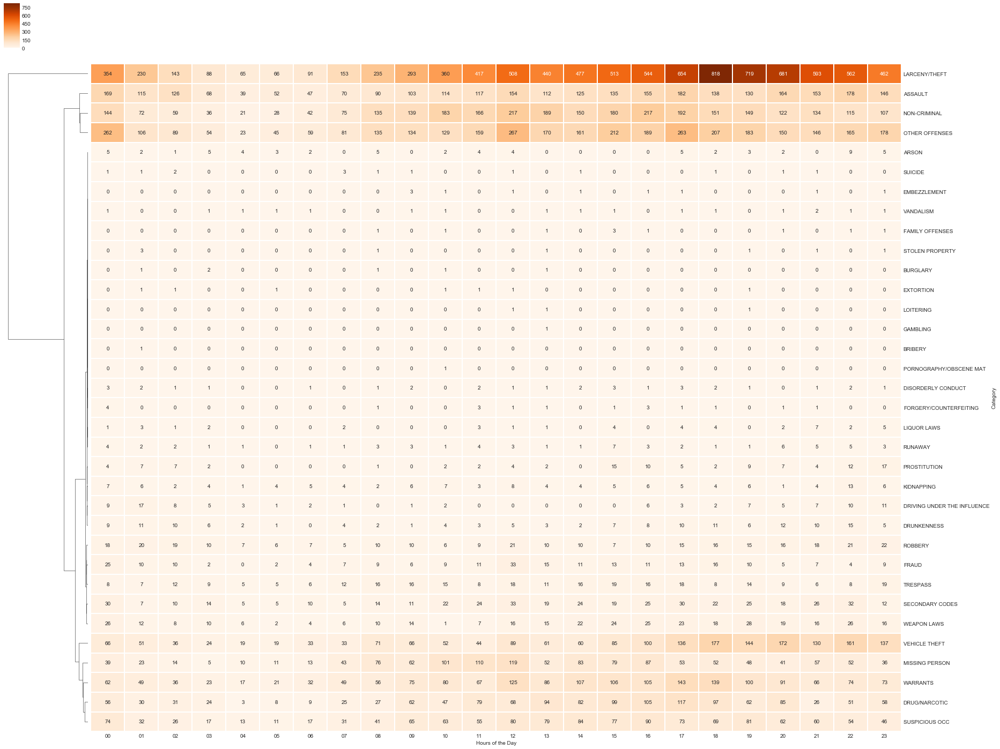

In [12]:
sfo_cat_time_df=sfo[['category','time_hr']].copy()
sfo_cat_time_df['count'] = 1
sfo_cat_time_grp = sfo_cat_time_df.groupby(['category','time_hr']).count()

sfo_cat_time_grp = sfo_cat_time_grp.reset_index()

sfo_cat_time_pvt = sfo_cat_time_grp.pivot('category','time_hr','count').fillna(0).astype(int)

g = sns.clustermap(sfo_cat_time_pvt, cmap='Oranges',figsize=(30,25),
               annot=True,fmt='d',col_cluster=False,linewidth='1',linecolor='white')
g.ax_heatmap.set_xlabel("Hours of the Day")
g.ax_heatmap.set_ylabel("Category")

'Larceny/ Theft' tops almost every hour of the day.

And now the distribution of crime categories across the week -

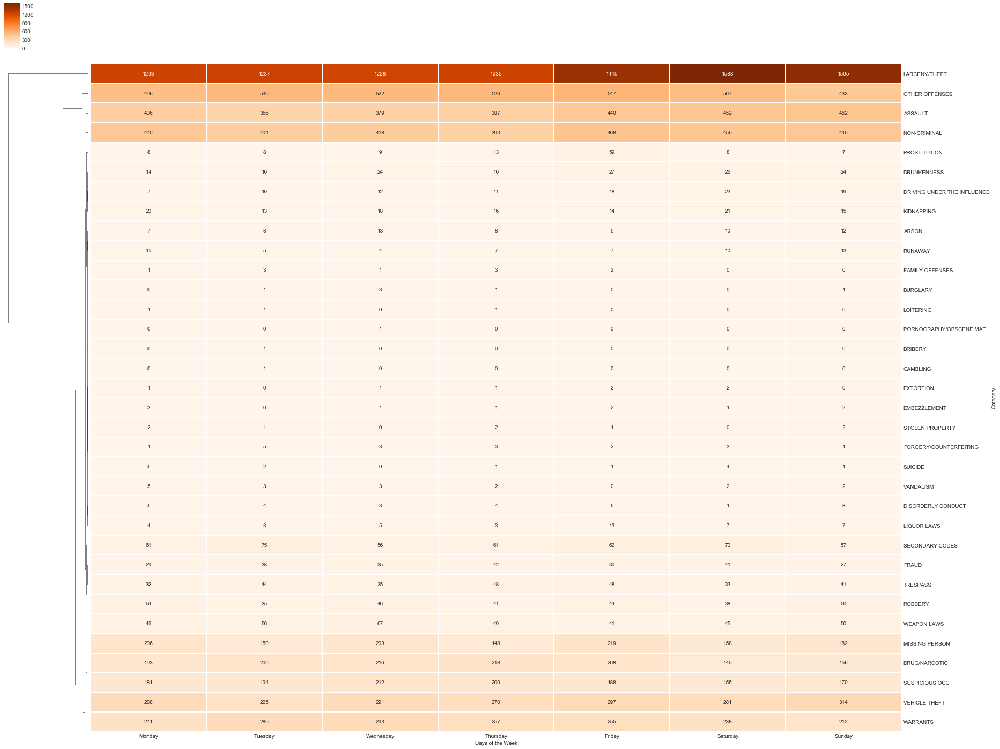

In [13]:
sfo_cat_day_df=sfo[['category','day']].copy()
sfo_cat_day_df['count'] = 1
sfo_cat_day_grp = sfo_cat_day_df.groupby(['category','day']).count()

sfo_cat_day_grp = sfo_cat_day_grp.reset_index()

sfo_cat_day_grp['day'] = pd.Categorical(sfo_cat_day_grp['day'], DAYS_OF_WEEK)

sfo_cat_day_pvt = sfo_cat_day_grp.pivot('category','day','count').fillna(0).astype(int)


g = sns.clustermap(sfo_cat_day_pvt, cmap='Oranges',figsize=(30,25),
               annot=True,fmt='d',col_cluster=False,linewidth='1',linecolor='white')
g.ax_heatmap.set_xlabel("Days of the Week")
g.ax_heatmap.set_ylabel("Category")

Again, 'Larceny/ Theft' incidents topping every day of the week.

With these observations on San Francisco crime incidents, let's move on to Seattle data

## 1.2. Seattle <a class="anchor" id="stl"></a>

In [14]:
# Load data set and take a quick preview
stl = pd.read_csv('seattle_incidents_summer_2014.csv')
stl.head()

//anaconda/lib/python2.7/site-packages/IPython/core/interactiveshell.py:2902: DtypeWarning: Columns (9) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,RMS CDW ID,General Offense Number,Offense Code,Offense Code Extension,Offense Type,Summary Offense Code,Summarized Offense Description,Date Reported,Occurred Date or Date Range Start,Occurred Date Range End,Hundred Block Location,District/Sector,Zone/Beat,Census Tract 2000,Longitude,Latitude,Location,Month,Year
0,483839,2015218538,2202,0,BURGLARY-FORCE-RES,2200,BURGLARY,06/28/2015 10:31:00 AM,06/28/2014 10:31:00 AM,06/28/2015 10:31:00 AM,6XX BLOCK OF NW 74 ST,J,J2,2900.3013,-122.364672,47.682524,"(47.68252427, -122.364671996)",6,2014
1,481252,2015213067,2610,0,FRAUD-IDENTITY THEFT,2600,FRAUD,06/24/2015 11:09:00 AM,06/01/2014 12:00:00 AM,06/24/2015 11:09:00 AM,23XX BLOCK OF 43 AV E,C,C2,6300.1004,-122.277080,47.639901,"(47.639900761, -122.277080248)",6,2014
2,481375,2015210301,2316,0,THEFT-MAIL,2300,MAIL THEFT,06/22/2015 09:22:00 AM,08/31/2014 09:00:00 AM,NaN,81XX BLOCK OF 11 AV SW,F,F3,11300.5013,-122.349312,47.529232,"(47.529232299, -122.349312181)",8,2014
3,481690,2015209327,2599,0,COUNTERFEIT,2500,COUNTERFEIT,06/21/2015 03:52:00 PM,06/20/2014 01:38:00 PM,NaN,6XX BLOCK OF PINE ST,M,M2,8200.1002,-122.334818,47.612368,"(47.612368448, -122.334817763)",6,2014
4,478198,2015207880,2399,3,THEFT-OTH,2300,OTHER PROPERTY,06/20/2015 11:59:00 AM,06/01/2014 11:59:00 AM,11/01/2014 12:00:00 PM,77XX BLOCK OF SUNNYSIDE AV N,J,J3,2700.2015,-122.329379,47.685960,"(47.685959879, -122.329378505)",6,2014


In [15]:
# Organize and rename the columns/ data labels, 
# Drop the columns that may not be useful and add any derived columns as needed

stl.drop(['General Offense Number','Offense Code','Offense Code Extension',
          'Offense Type','Summary Offense Code','Date Reported',
          'Occurred Date Range End','Hundred Block Location','Census Tract 2000',
          'Month','Year'],inplace=True,axis=1)

stl.columns = ['inc_no','category','date','district','zone','long','lat','location']
stl['date'] = pd.to_datetime(stl['date'])
stl['time_hr'] = stl['date'].dt.hour
stl['day'] = stl['date'].dt.weekday_name
stl['week'] = stl['date'].dt.weekofyear
stl['month'] = (stl['date'].dt.month).apply(lambda x: calendar.month_abbr[x])

stl.head()

,inc_no,category,date,district,zone,long,lat,location,time_hr,day,week,month
0,483839,BURGLARY,2014-06-28 10:31:00,J,J2,-122.364672,47.682524,"(47.68252427, -122.364671996)",10,Saturday,26,Jun
1,481252,FRAUD,2014-06-01 00:00:00,C,C2,-122.277080,47.639901,"(47.639900761, -122.277080248)",0,Sunday,22,Jun
2,481375,MAIL THEFT,2014-08-31 09:00:00,F,F3,-122.349312,47.529232,"(47.529232299, -122.349312181)",9,Sunday,35,Aug
3,481690,COUNTERFEIT,2014-06-20 13:38:00,M,M2,-122.334818,47.612368,"(47.612368448, -122.334817763)",13,Friday,25,Jun
4,478198,OTHER PROPERTY,2014-06-01 11:59:00,J,J3,-122.329379,47.685960,"(47.685959879, -122.329378505)",11,Sunday,22,Jun


In [16]:
# For the zero values of lat and long columns, use the mean values of the same zone.
# This should be a decent approximation for the missing values

stl_zone_loc = stl[(stl['long']!=0)&(stl['lat']!=0)].groupby('zone')[['long','lat']].mean()

for index, row in stl_zone_loc.iterrows():
     stl.loc[(stl['zone'] == index) & (stl['long'] == 0),'long'] = row[0]
     stl.loc[(stl['zone'] == index) & (stl['lat'] == 0),'lat'] = row[1]

Let's plot all the incidents on the Seattle map using the lat, long values.

In [17]:
stl_map_1=flm.Map(
    location=[stl[stl['lat'] != 0]['lat'].mean(), stl[stl['long'] != 0]['long'].mean()],
    zoom_start=11,min_zoom=11,max_zoom=11)


stl_by_loc = stl.groupby(['lat','long'], as_index='False')
stl_loc_stats = stl_by_loc['inc_no'].count()
stl_loc_stats = stl_loc_stats.reset_index()
stl_loc_stats
for index,row in stl_loc_stats.iterrows():
    lat,lng,count = row['lat'],row['long'], row['inc_no']
    
    if lat != 0 and lng != 0:
        flm.CircleMarker(
            [lat,lng],
            radius=count*0.01,
            popup="(" + str(lat) + "," + str(lng) + ") : " + str(int(count)) + " incidents",
            color='#DF0804',
            fill_color='#DF0804'
        ).add_to(stl_map_1)


# Plotting this map takes around 7 minutes.
stl_map_1

**_Click on the map markers for details_**

Now, let's plot the incidents count consolidated for each districts and zones.

In [18]:
stl_map_2=flm.Map(
    location=[stl[stl['lat'] != 0]['lat'].mean(), stl[stl['long'] != 0]['long'].mean()],
    zoom_start=11, min_zoom=11, max_zoom=11)

stl_by_zone = stl.groupby('zone', as_index='False')
stl_zone_stats = stl_by_zone[['lat','long']].mean()
stl_zone_stats['count'] = stl_by_zone['zone'].count()
stl_zone_stats = stl_zone_stats.reset_index()

for index,row in stl_zone_stats.iterrows():
    zone,lat,lng,count = row['zone'], row['lat'],row['long'], row['count']
    if lat !=0 and lng != 0:
        flm.CircleMarker(
            [lat,lng],
            radius=count*0.004,
            popup="Zone " + zone.title() + " : "+ str(count) + ' incidents',
            color='#F73E52',
            fill_color='#F73E52'
        ).add_to(stl_map_2)

stl_map_2

stl_by_district = stl.groupby('district', as_index='False')
stl_district_stats = stl_by_district[['lat','long']].mean()
stl_district_stats['count'] = stl_by_district['district'].count()
stl_district_stats = stl_district_stats.reset_index()

for index,row in stl_district_stats.iterrows():
    dist,lat,lng,count = row['district'], row['lat'],row['long'], row['count']
    if lat !=0 and lng != 0:
        flm.CircleMarker(
            [lat,lng],
            radius=count*0.004,
            popup="District " + dist.title() + " : "+ str(count) + ' incidents',
            color='#C12515',
            fill_color='#C12515'
        ).add_to(stl_map_2)

stl_map_2


**_Click on the map markers for details_**

Let's plot the trend month over month and over the days of the week

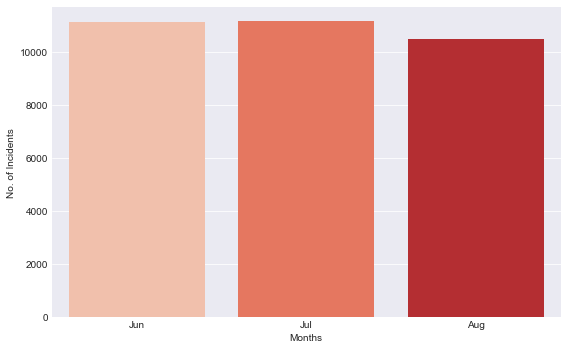

In [19]:
plt.figure(figsize=(8,5))
sns.countplot(data=stl, x='month', order = SUMMER_MONTHS, palette='Reds')
plt.xlabel("Months")
plt.ylabel("No. of Incidents")
plt.tight_layout()

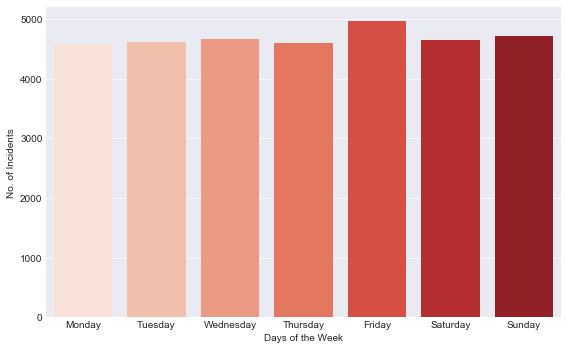

In [20]:
plt.figure(figsize=(8,5))
sns.countplot(data=stl, x='day', order = DAYS_OF_WEEK, palette='Reds')
plt.xlabel("Days of the Week")
plt.ylabel("No. of Incidents")
plt.tight_layout()

Month over month counts doesn't show any specific trend. However, we can say Aug has lower incidents than Jun and Jul. Incidents over days of the week remain almost same, except with high counts on Fridays.

Something to note here. Both these two trends are different from what we have seen for San Francisco.

Now, let's plot the heat map for the days of the week and the time of the day

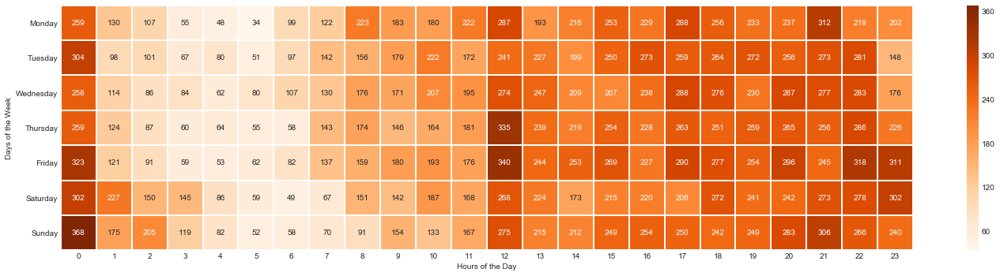

In [21]:
stl_day_time_df=stl[['day','time_hr']].copy()
stl_day_time_df['count'] = 1
stl_day_time_grp = stl_day_time_df.groupby(['day','time_hr']).count()

stl_day_time_grp = stl_day_time_grp.reset_index()

stl_day_time_grp['day'] = pd.Categorical(
    stl_day_time_grp['day'],
    DAYS_OF_WEEK)

plt.figure(figsize=(20,5))
sns.heatmap(stl_day_time_grp.pivot('day','time_hr','count'), cmap='Oranges',
            annot=True, fmt='d',linecolor='white',linewidth='1')
plt.xlabel("Hours of the Day")
plt.ylabel("Days of the Week")
plt.tight_layout()

Peak values are concentrated around noon and the midnight. Otherwise, incidents are rather evenly distributed across all days of the week with very
few exceptions.

Let's plot cluster plot to compare crime categories across different districts.

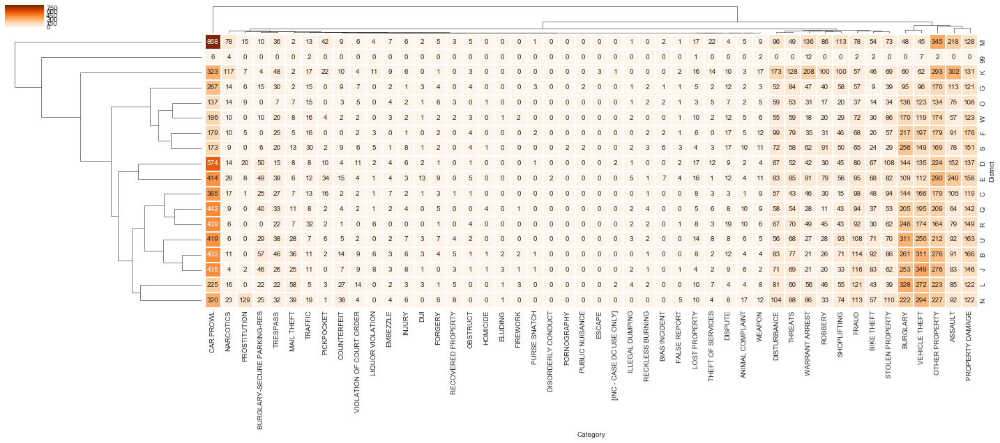

In [22]:
stl_dist_cat_df=stl[['district','category']].copy()
stl_dist_cat_df['count'] = 1
stl_dist_cat_grp = stl_dist_cat_df.groupby(['district','category']).count()

stl_dist_cat_grp = stl_dist_cat_grp.reset_index()

stl_dist_cat_pvt = stl_dist_cat_grp.pivot('district','category','count').fillna(0).astype(int)

g = sns.clustermap(stl_dist_cat_pvt,figsize=(25,8),cmap='Oranges',
               linewidth='1',linecolor='white',annot=True, fmt='d')
g.ax_heatmap.set_xlabel("Category")
g.ax_heatmap.set_ylabel("District")

Car Prowl appears to be the top crime category and District M appears to be the high crime district.

Now, let's observe the spread of different crimes over time of the day.

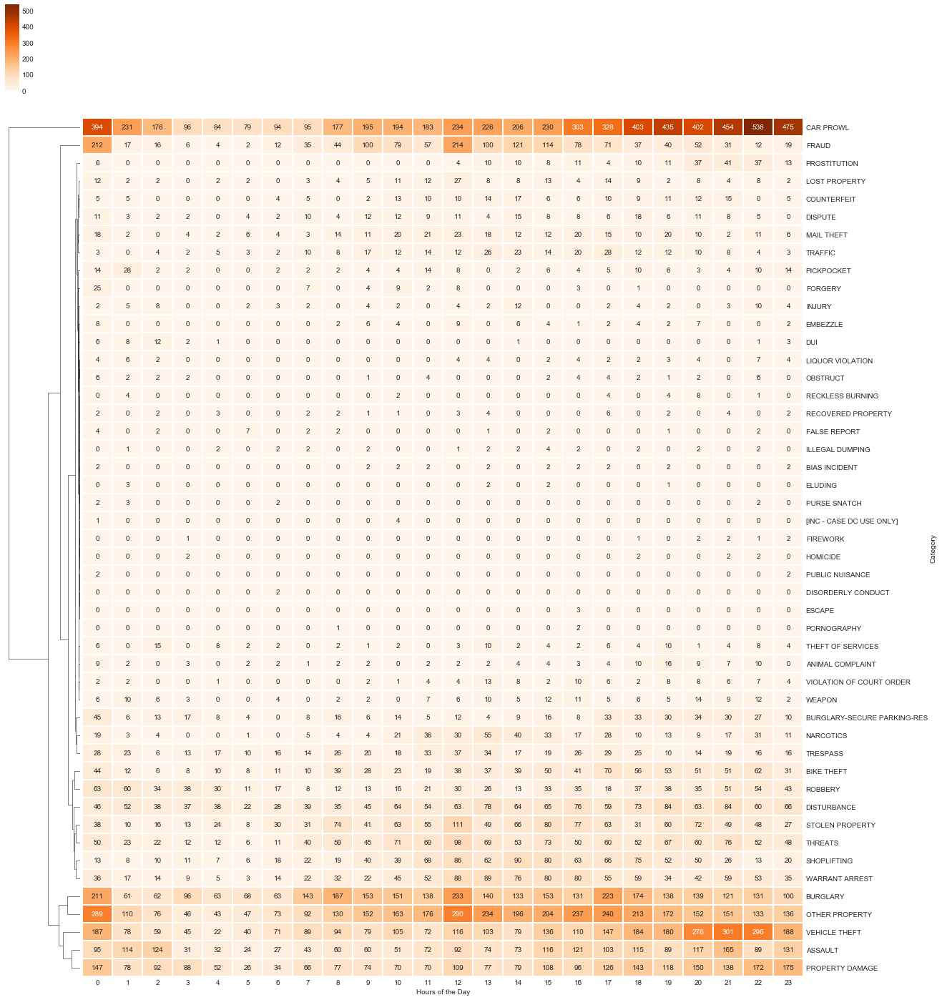

In [23]:
stl_cat_time_df=stl[['category','time_hr']].copy()
stl_cat_time_df['count'] = 1
stl_cat_time_grp = stl_cat_time_df.groupby(['category','time_hr']).count()

stl_cat_time_grp = stl_cat_time_grp.reset_index()

stl_cat_time_pvt = stl_cat_time_grp.pivot('category','time_hr','count').fillna(0).astype(int)

g = sns.clustermap(stl_cat_time_pvt, cmap='Oranges',figsize=(20,25),annot=True,fmt='d',
               col_cluster=False,linewidth='1',linecolor='white')
g.ax_heatmap.set_xlabel("Hours of the Day")
g.ax_heatmap.set_ylabel("Category")

Though the total incidents peak at both noon and midnight, the top crime 'Car Prowl' shows an upward trend as the day progresses and through the midnight, and peaking at 11 PM to 12 AM window.

Next, let's see the spread of crime categories over the days of the week.

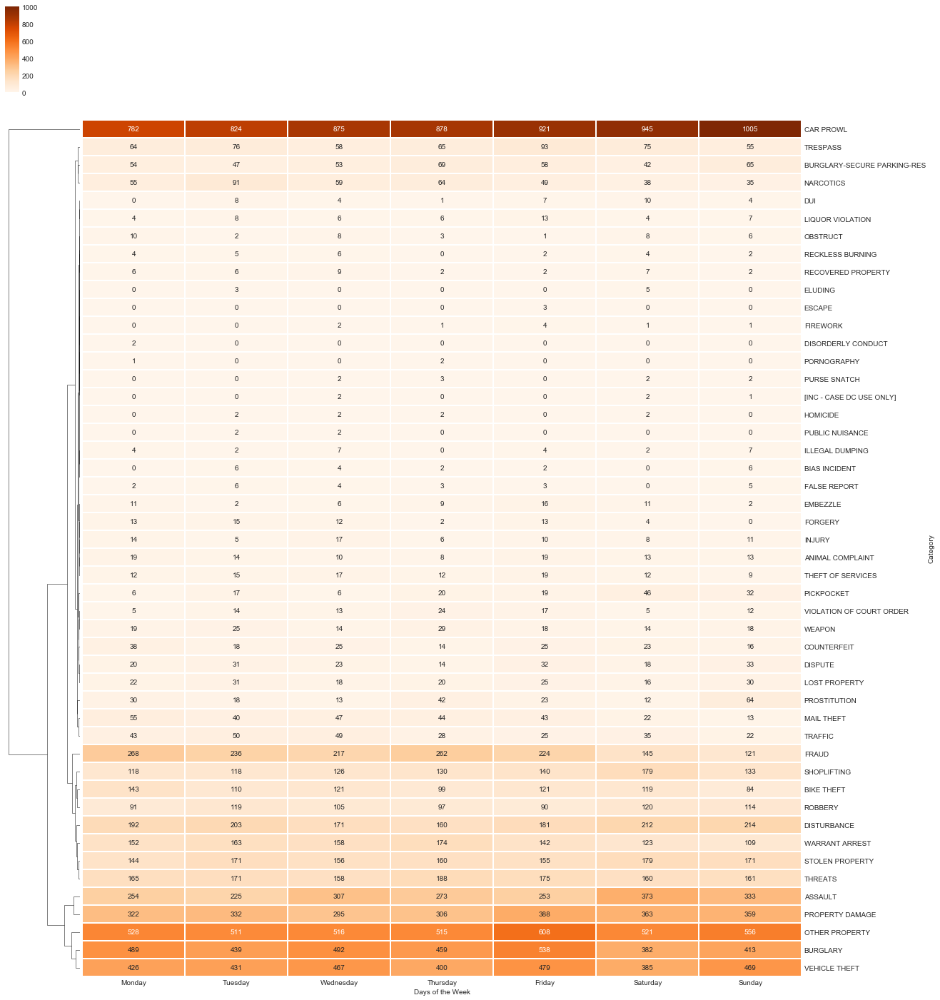

In [24]:
stl_cat_day_df=stl[['category','day']].copy()
stl_cat_day_df['count'] = 1
stl_cat_day_grp = stl_cat_day_df.groupby(['category','day']).count()

stl_cat_day_grp = stl_cat_day_grp.reset_index()

stl_cat_day_grp['day'] = pd.Categorical(
    stl_cat_day_grp['day'],
    DAYS_OF_WEEK)

stl_cat_day_pvt = stl_cat_day_grp.pivot('category','day','count').fillna(0).astype(int)

g = sns.clustermap(stl_cat_day_pvt, cmap='Oranges',figsize=(20,25),annot=True,fmt='d',
               col_cluster=False,linewidth='1',linecolor='white')
g.ax_heatmap.set_xlabel("Days of the Week")
g.ax_heatmap.set_ylabel("Category")

'Car Prowl' shows a steady upward trend through the week (Monday to Sunday), and peaking on Sunday.

Let's wrap up the observations on Seattle, and proceed to do some comparisons between San Francisco and Seattle.

## 1.3. San Francisco vs. Seattle <a class="anchor" id="sfo_stl"></a>

Following is a quick list of potentially interesting comparisons, I'd like to explore -
1. Crime spread over the weak and over the period of a day.
2. Top crime categories
3. Month over month crime trend
4. We can drill down to weekly level and see week over week incidents, to see if there is a linear trend, or at the least similar to month over month trend.
5. Pick the high crime districts, and probably look for top crime categories
6. We can run same explorations for the Low crime Districts as well, results might be interesting.

Let's try and explore them now.

First, month over month trend

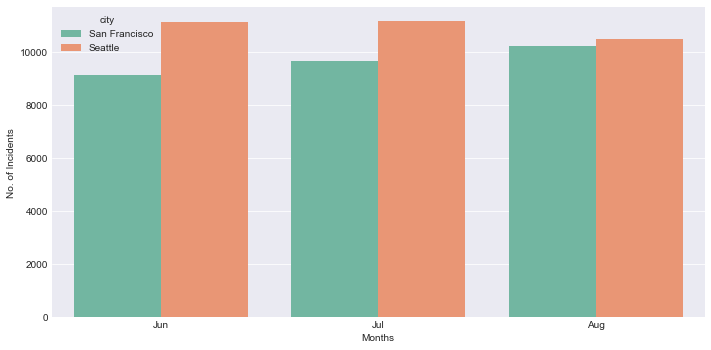

In [25]:
sns.set_style("darkgrid")
sfo_month = sfo.groupby('month', as_index=False)['inc_no'].count()
sfo_month['city'] = 'San Francisco'

stl_month = stl.groupby('month', as_index=False)['inc_no'].count()
stl_month['city'] = 'Seattle'

monthly_count = pd.concat([sfo_month,stl_month])

plt.figure(figsize=(10,5))
sns.barplot(data=monthly_count, x='month',  y='inc_no', 
            hue='city', order = ['Jun','Jul','Aug'], palette = 'Set2')
plt.xlabel("Months")
plt.ylabel("No. of Incidents")
plt.tight_layout()

Two key observations here -
1. While San Francisco shows an upward trend, Seattle doesn't show any significant trend.
2. No. of crime incidents on Seattle is higher than San Francisco for every month, even for San Francisco's peak values in August. If Seattle were more populous city than San Francisco, the crime per capita could have been favorable to Seattle. However, it appears that San Francisco is more populous than Seattle, and our observation shows that San Francisco is a safer city compared to Seattle.

Now, let's see the spread over the week

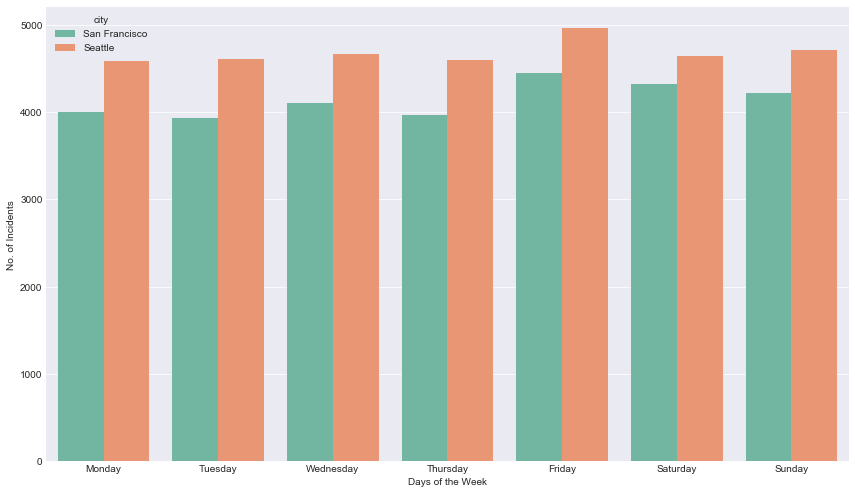

In [26]:
sfo_day = sfo.groupby('day', as_index=False)['inc_no'].count()
sfo_day['city'] = 'San Francisco'

stl_day = stl.groupby('day', as_index=False)['inc_no'].count()
stl_day['city'] = 'Seattle'

day_count = pd.concat([sfo_day,stl_day])

plt.figure(figsize=(12,7))
sns.barplot(data=day_count, x='day',  y='inc_no', 
            hue='city', order = DAYS_OF_WEEK, palette = 'Set2')
plt.xlabel("Days of the Week")
plt.ylabel("No. of Incidents")
plt.tight_layout()

Spread over the week shows the same observations we made previously.
1. San Francisco has higher crime rates over the weekends, whereas Seattle shows a common trend across the week with an exception of peak values on Fridays.
2. Seattle has more crimes than San Francisco, spread over the week as well.

Next, let's see the incidents on week over week basis (weeks 22 to 35 of the year)

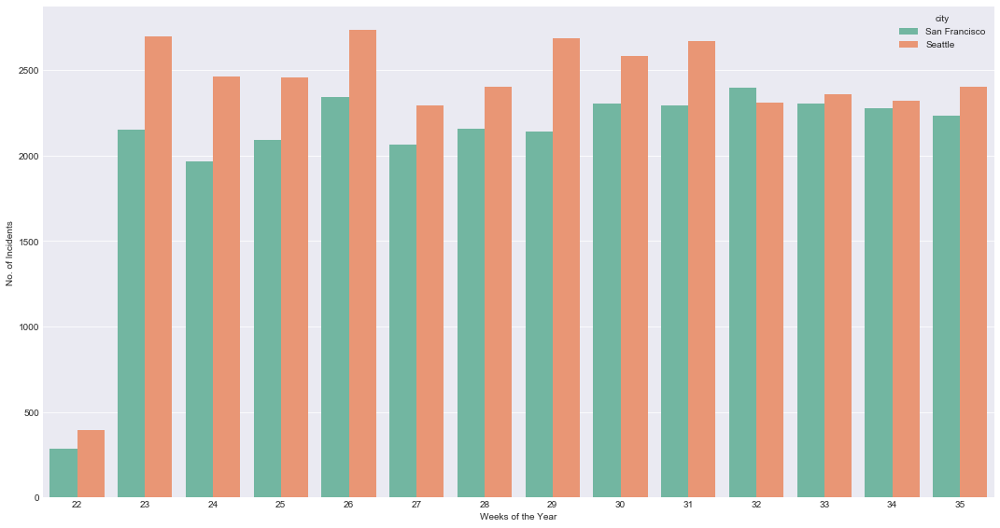

In [27]:
sfo_week = sfo.groupby('week', as_index=False)['inc_no'].count()
sfo_week['city'] = 'San Francisco'

stl_week = stl.groupby('week', as_index=False)['inc_no'].count()
stl_week['city'] = 'Seattle'

week_count = pd.concat([sfo_week, stl_week])

plt.figure(figsize=(15,8))
sns.barplot(data=week_count, x='week',  y='inc_no', hue='city', palette = 'Set2')
plt.xlabel("Weeks of the Year")
plt.ylabel("No. of Incidents")
plt.tight_layout()

1. San Francisco shows a steady but slow upward trend throughout these summer weeks, with minor ups and downs along the way.
2. Seattle doesn't show any significant trend on week over week trend as well.

Next, let's plot the spread over the day

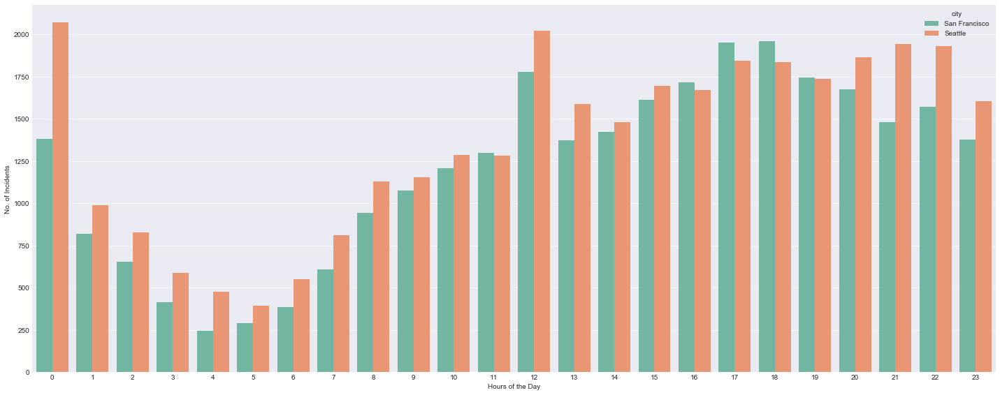

In [28]:
sfo_time = sfo.groupby('time_hr', as_index=False)['inc_no'].count()
sfo_time['city'] = 'San Francisco'

stl_time = stl.groupby('time_hr', as_index=False)['inc_no'].count()
stl_time['city'] = 'Seattle'

time_count = pd.concat([sfo_time, stl_time])
time_count['time_hr'] = time_count['time_hr'].astype('int')

plt.figure(figsize=(20,8))
sns.barplot(data=time_count, x='time_hr',  y='inc_no', hue='city', palette = 'Set2')
plt.xlabel("Hours of the Day")
plt.ylabel("No. of Incidents")
plt.tight_layout()

Seattle's crime numbers are higher than San Francisco for almost every typical hour of the day, except the 4PM to 8PM window around which San Francisco crime incidents peak.

We also can see a wider gap (Seattle on higher side) for the late night hours - 9PM to 1AM

Let's replot the heatmap for Days of the Week across Time of the day, for both San Francisco and Seattle side by side.

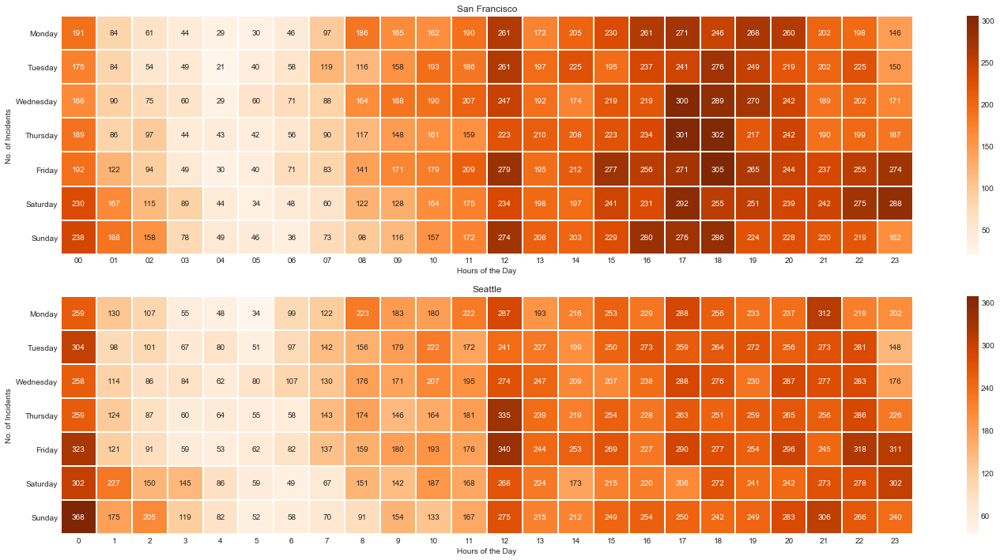

In [29]:
fig,axn = plt.subplots(2, 1, figsize=(20,10))

axn[0].set(title='San Francisco')
sns.heatmap(sfo_day_time_grp.pivot('day','time_hr','count'), cmap='Oranges',
            annot=True, fmt='d',linecolor='white',linewidth='1',ax=axn[0])
axn[0].set_xlabel("Hours of the Day")
axn[0].set_ylabel("No. of Incidents")

axn[1].set(title='Seattle')
sns.heatmap(stl_day_time_grp.pivot('day','time_hr','count'), cmap='Oranges',
            annot=True, fmt='d',linecolor='white',linewidth='1',ax=axn[1])
axn[1].set_xlabel("Hours of the Day")
axn[1].set_ylabel("No. of Incidents")

plt.tight_layout()

Observations are same as the previous ones. Charts replotted for side by side comparison.

Now, moving on to the comparisons on categories - 

For an effective comparison, we may need to rename, split or combine different categories on both datasets.

First, let's examine the different categories on both San Francisco and Seattle.

In [30]:
pd.DataFrame(sfo.groupby('category')['inc_no'].count().sort_values(ascending=False))

,inc_no
category,
LARCENY/THEFT,9466
OTHER OFFENSES,3567
NON-CRIMINAL,3023
ASSAULT,2882
VEHICLE THEFT,1966
WARRANTS,1782
DRUG/NARCOTIC,1345
SUSPICIOUS OCC,1300
MISSING PERSON,1266


In [31]:
pd.DataFrame(stl.groupby('category')['inc_no'].count().sort_values(ascending=False))

,inc_no
category,
CAR PROWL,6230
OTHER PROPERTY,3755
BURGLARY,3212
VEHICLE THEFT,3057
PROPERTY DAMAGE,2365
ASSAULT,2018
FRAUD,1473
DISTURBANCE,1333
THREATS,1178


Above list shows that the terms are not common across both the data sets. 
We can try and fix all the categories to use a common term, but for this assignment, let's restrict this exercise to the top few categories.


To start with, let's examine 'Larceny/Theft' category of San Francisco. Let's look into the descriptions for more details and see if we can make it comparable to Seattle data set.

In [32]:
pd.DataFrame(sfo[sfo['category'] =='LARCENY/THEFT'].groupby('desc')['inc_no'].count())

,inc_no
desc,
ATTEMPTED AUTO STRIP,1
ATTEMPTED GRAND THEFT FROM PERSON,3
ATTEMPTED PETTY THEFT OF PROPERTY,3
ATTEMPTED SHOPLIFTING,5
ATTEMPTED THEFT FROM A BUILDING,7
ATTEMPTED THEFT FROM LOCKED VEHICLE,59
ATTEMPTED THEFT FROM UNLOCKED VEHICLE,2
ATTEMPTED THEFT OF A BICYCLE,5
EMBEZZLEMENT FROM DEPENDENT OR ELDER ADULT BY CARETAKER,15


From the descriptions, we see that 'Larceny/ Theft' includes 'Car Prowl' incidents also, 
and constitutes larger portion too. (GRAND THEFT FROM LOCKED AUTO - 3766)

** Another interesting observation here ** - Theft from unlocked vehicles is very less than that from the locked vehicles. 
Does this mean locking the vehicles doesn't necessarily make it safer? May be, leaving valuable things in plain sight attracts criminals than leaving the vehicle unlocked.

Let's move ahead and rename the categories related to theft from auto to 'Car Prowl' to match the (top) category on Seattle dataset.

In [33]:
car_prowl_desc = ['ATTEMPTED THEFT FROM LOCKED VEHICLE','ATTEMPTED THEFT FROM UNLOCKED VEHICLE',
                 'GRAND THEFT FROM LOCKED AUTO','GRAND THEFT FROM UNLOCKED AUTO',
                 'PETTY THEFT FROM LOCKED AUTO','PETTY THEFT FROM UNLOCKED AUTO']

sfo.loc[:,'category'][sfo['desc'].isin(car_prowl_desc)] = 'CAR PROWL'

# The below warning can be ignored

/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


Next, looking at the Burglary numbers in Seattle dataset, it appears to be a larger category than it was meant for in San Francisco

For our comparisons purpose, let's combine both SFO's 'Larceny/ Theft' (excluding car prowl) and 'Burglary' into a common new 'Larceny/ Theft/ Burglary' category. Similarly on Seattle's dataset, let's combine 'Burglary' and 'Burglary-Secure Parking-Res' into the same 'Larceny/ Theft/ Burglary' category.

This may not be accurate, but serves as a decent approximation to compare common theft categories in both cities.

In [34]:
sfo['category'].replace('LARCENY/THEFT','LARCENY/THEFT/BURGLARY', inplace=True)
sfo['category'].replace('BURGLARY','LARCENY/THEFT/BURGLARY', inplace=True)

stl['category'].replace('BURGLARY','LARCENY/THEFT/BURGLARY', inplace=True)
stl['category'].replace('BURGLARY-SECURE PARKING-RES','LARCENY/THEFT/BURGLARY', inplace=True)

And, couple of other renames too -

In [35]:
stl['category'].replace('WEAPON','WEAPON LAWS', inplace=True)
sfo['category'].replace('DRUG/NARCOTIC','NARCOTICS', inplace=True)

With those changes completed, let's hand pick few common crimes and compare SFO and Seattle data sets

In [36]:
common_crimes = ['LARCENY/THEFT/BURGLARY','CAR PROWL','VEHICLE THEFT','ASSAULT', 
                 'ROBBERY', 'FRAUD', 'PROSTITUTION' ,'WEAPON LAWS', 'NARCOTICS']

sfo_cat_count = sfo[sfo['category'].isin(common_crimes)].groupby('category', as_index=False)['inc_no'].count()
sfo_cat_count['city'] = 'San Francisco'
# sfo_cat_count['category'] = sfo_cat_count['category'].str.title()

stl_cat_count = stl[stl['category'].isin(common_crimes)].groupby('category', as_index=False)['inc_no'].count()
stl_cat_count['city'] = 'Seattle'

common_cat_counts = pd.concat([sfo_cat_count, stl_cat_count])

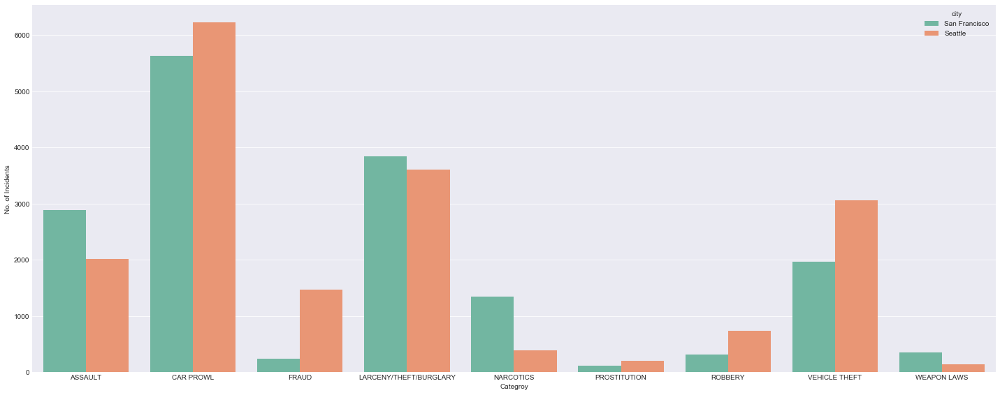

In [37]:
plt.figure(figsize=(20,8))
sns.barplot(data=common_cat_counts, x='category', y='inc_no', hue = 'city', palette = 'Set2')
plt.xlabel("Categroy")
plt.ylabel("No. of Incidents")
plt.tight_layout()

With categories renamed, let's check again the top crime categories for both San Francisco and Seattle.

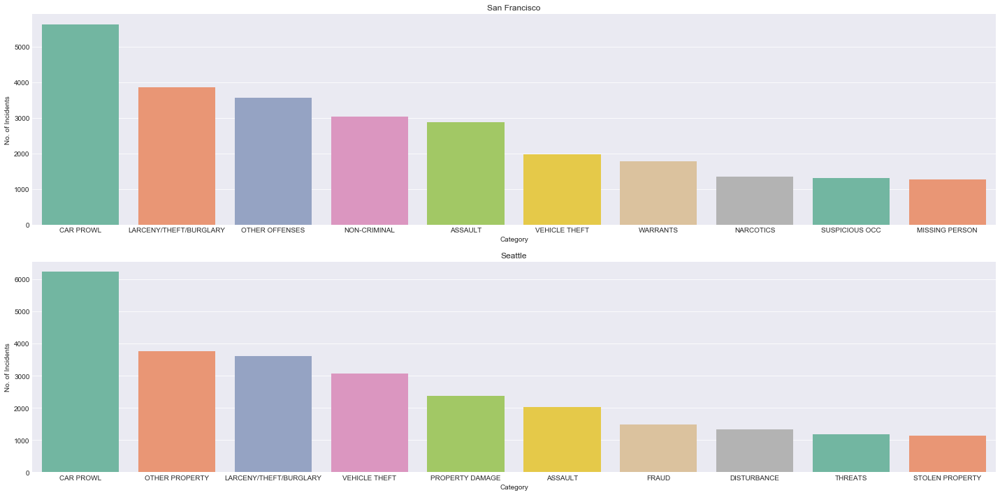

In [38]:
sfo_top_cat = sfo.groupby('category', as_index=False)['inc_no'].count().sort_values('inc_no', ascending=False).head(10)
stl_top_cat = stl.groupby('category', as_index=False)['inc_no'].count().sort_values('inc_no', ascending=False).head(10)

fig,axn = plt.subplots(2, 1, figsize=(20,10))

axn[0].set(title='San Francisco')
sns.barplot(data = sfo_top_cat, x='category', y='inc_no', ax=axn[0], palette='Set2')
axn[0].set_xlabel("Category")
axn[0].set_ylabel("No. of Incidents")

axn[1].set(title='Seattle')
sns.barplot(data = stl_top_cat, x='category', y='inc_no', ax=axn[1], palette='Set2')
axn[1].set_xlabel("Category")
axn[1].set_ylabel("No. of Incidents")

plt.tight_layout()

** Interestingly, after carving out the 'Car Prowl' category from the 'Larceny/Theft', we find that 'Car Prowl' happens to be the top crime category in San Francisco as well !!**

Let's move ahead and figure out the High crime and Low crime districts for San Francisco and Seattle.

In [39]:
# Figure out High Crime and Low Crime districts.
pd.DataFrame(sfo.groupby('district')['inc_no'].count().sort_values(ascending=False))

,inc_no
district,
SOUTHERN,5739
MISSION,3700
NORTHERN,3589
CENTRAL,3513
BAYVIEW,2725
INGLESIDE,2378
TENDERLOIN,2257
TARAVAL,1853
PARK,1693


In [40]:
pd.DataFrame(stl.groupby('district')['inc_no'].count().sort_values(ascending=False))

,inc_no
district,
M,2642
K,2379
B,2338
N,2333
E,2255
J,2204
U,2160
D,2063
L,1982


Let's pick the top 4 and low 3 as High and Low Crime Districts.

_Reason for top 4 instead of top 3 - difference between 3rd and 4th entries is very less compared for the 4th entry to be left. Coincidentally, this is same for both San Francisco and Seattle._

In [41]:
sfo_high_crime_dist=['SOUTHERN','MISSION','NORTHERN','CENTRAL']
sfo_low_crime_dist=['RICHMOND','PARK','TARAVAL']

stl_high_crime_dist=['M','K','B','N']
stl_low_crime_dist=['O','W','G']

Let's peek at the high crime and low crime districts for the top crime categories

First, for San Francisco

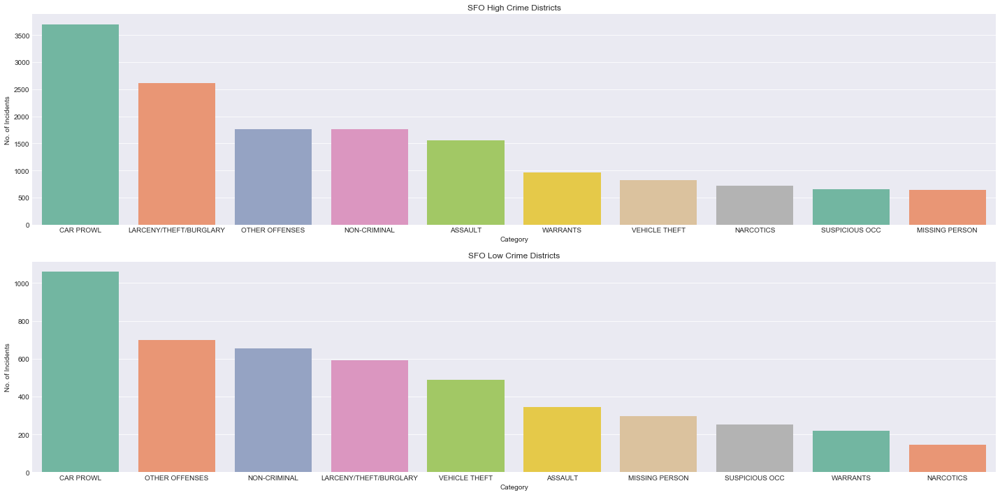

In [42]:
sfo_high_crimes_top_cat = sfo[sfo['district'].isin(sfo_high_crime_dist)].groupby('category', as_index=False)['inc_no'].count().sort_values('inc_no', ascending=False).head(10)
sfo_low_crimes_top_cat = sfo[sfo['district'].isin(sfo_low_crime_dist)].groupby('category', as_index=False)['inc_no'].count().sort_values('inc_no', ascending=False).head(10)

fig,axn = plt.subplots(2, 1, figsize=(20,10))

axn[0].set(title='SFO High Crime Districts')
sns.barplot(data = sfo_high_crimes_top_cat, x='category', y='inc_no', ax=axn[0], palette = 'Set2')
axn[0].set_xlabel("Category")
axn[0].set_ylabel("No. of Incidents")

axn[1].set(title='SFO Low Crime Districts')
sns.barplot(data = sfo_low_crimes_top_cat, x='category', y='inc_no', ax=axn[1], palette = 'Set2')
axn[1].set_xlabel("Category")
axn[1].set_ylabel("No. of Incidents")

plt.tight_layout()

Well, top 10 crime categories for both High crime and Low crime SFO districts are exactly the same, however not in the exact same order. **'Car Prowl' tops in both the groups.**

Now, for Seattle

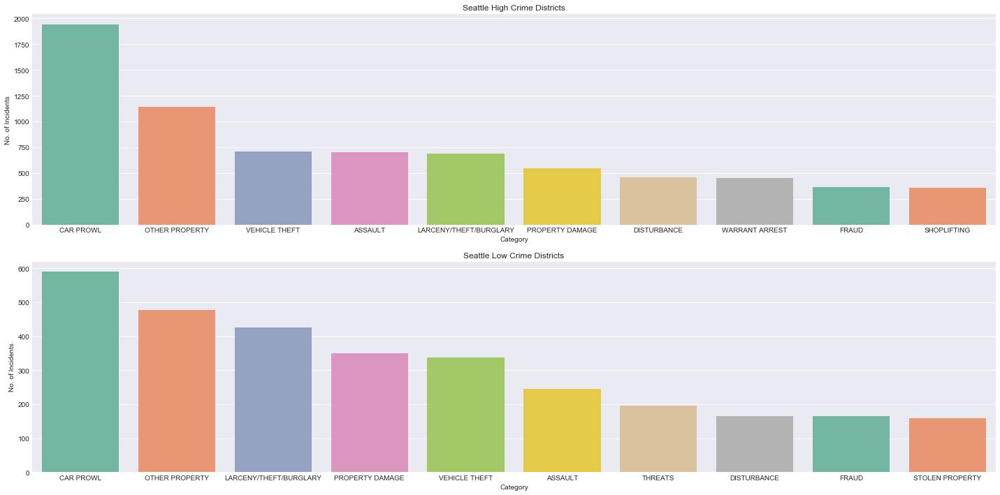

In [43]:
stl_high_crimes_top_cat = stl[stl['district'].isin(stl_high_crime_dist)].groupby('category', as_index=False)['inc_no'].count().sort_values('inc_no', ascending=False).head(10)
stl_low_crimes_top_cat = stl[stl['district'].isin(stl_low_crime_dist)].groupby('category', as_index=False)['inc_no'].count().sort_values('inc_no', ascending=False).head(10)

fig,axn = plt.subplots(2, 1, figsize=(20,10))

axn[0].set(title='Seattle High Crime Districts')
sns.barplot(data = stl_high_crimes_top_cat, x='category', y='inc_no', ax=axn[0], palette = 'Set2')
axn[0].set_xlabel("Category")
axn[0].set_ylabel("No. of Incidents")

axn[1].set(title='Seattle Low Crime Districts')
sns.barplot(data = stl_low_crimes_top_cat, x='category', y='inc_no', ax=axn[1], palette = 'Set2')
axn[1].set_xlabel("Category")
axn[1].set_ylabel("No. of Incidents")

plt.tight_layout()

For Seattle, 8 out of top 10 crime categories are same for both High crime and Low crime districts.

'Warrant Arrest' and 'Shoplifting' appears on the top 10 of High Crime Districts, whereas 'Threats' and 'Stolen Property' shows up instead on the Low crime districts. **And again, 'Car Prowl' tops in both the groups.**

## 2. Hypothesis and supporting analysis <a class="anchor" id="hyp"></a>

During the above exploration, we observed that Car Prowl topped all the categories for both the cities. Let's focus on this finding and analyze futher to support hypothesis if Car Prowl truly tops all crime categories by a wider margin from different perspectives.

First, let's compare the top 10 crime categories for both San Francisco and Seattle.

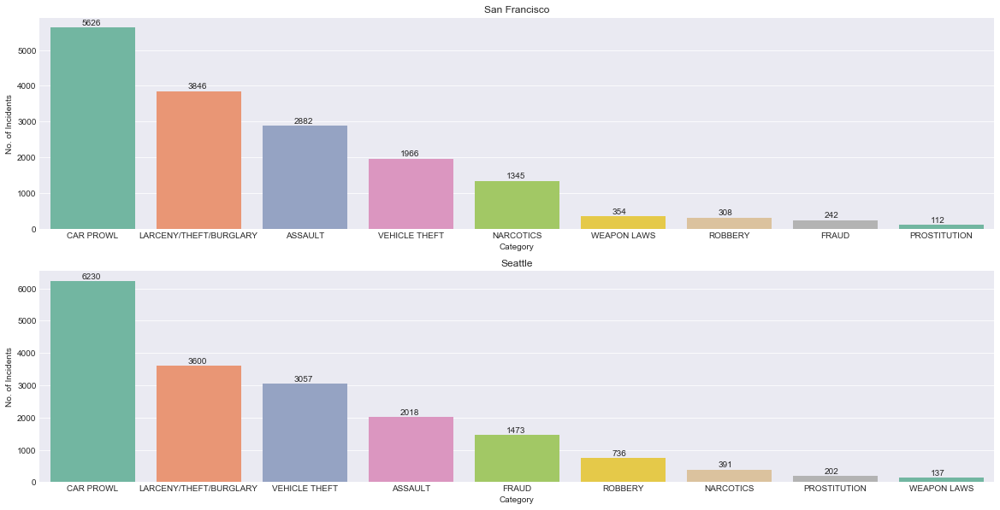

In [44]:
sfo_cat_count.sort_values('inc_no', ascending=False, inplace=True)
stl_cat_count.sort_values('inc_no', ascending=False, inplace=True)


fig,axn = plt.subplots(2, 1, figsize=(20,10))

axn[0].set(title='San Francisco') 
sns.barplot(data=sfo_cat_count,x='category', y='inc_no', ax=axn[0], palette='Set2')
axn[0].set_xlabel("Category")
axn[0].set_ylabel("No. of Incidents")
for p in axn[0].patches:
    axn[0].annotate(str(int(p.get_height())), (p.get_x()+0.3, p.get_height() + 70))

axn[1].set(title='Seattle') 
sns.barplot(data=stl_cat_count,x='category', y='inc_no', ax=axn[1], palette='Set2')
axn[1].set_xlabel("Category")
axn[1].set_ylabel("No. of Incidents")
for p in axn[1].patches:
    axn[1].annotate(str(int(p.get_height())), (p.get_x()+0.3, p.get_height() + 70))


From the above charts, we infer that 'Car Prowl' leads the crime category by a larger gap. We can derive the actual gap from the above numbers and express it in Percentage Difference -

**San Francisco : 37.58% **

**Seattle : 53.51% **

_(Calculations below)_

We can also see that these incidents are higher in Seattle than San Francisco. However, it's not by a very large margin.

In [45]:
print "San Francisco : %0.2f" % ((5626-3846)*100/float((5626+3846)/2)) + "%"
print "Seattle : %0.2f" % ((6230-3600)*100/float((6230+3600)/2)) + "%"

San Francisco : 37.58%
Seattle : 53.51%


Furthermore for both San Francisco and Seattle, we can see that 'Car Prowl' topped all the categories every week throughout the summer (ignoring the partial week at the beginning).

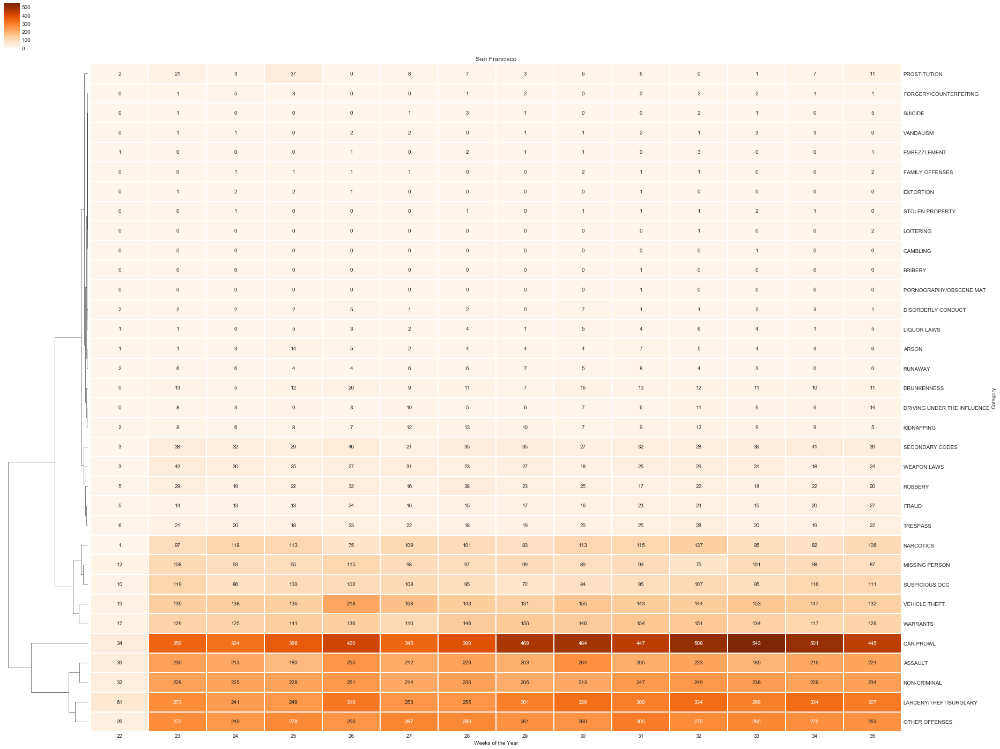

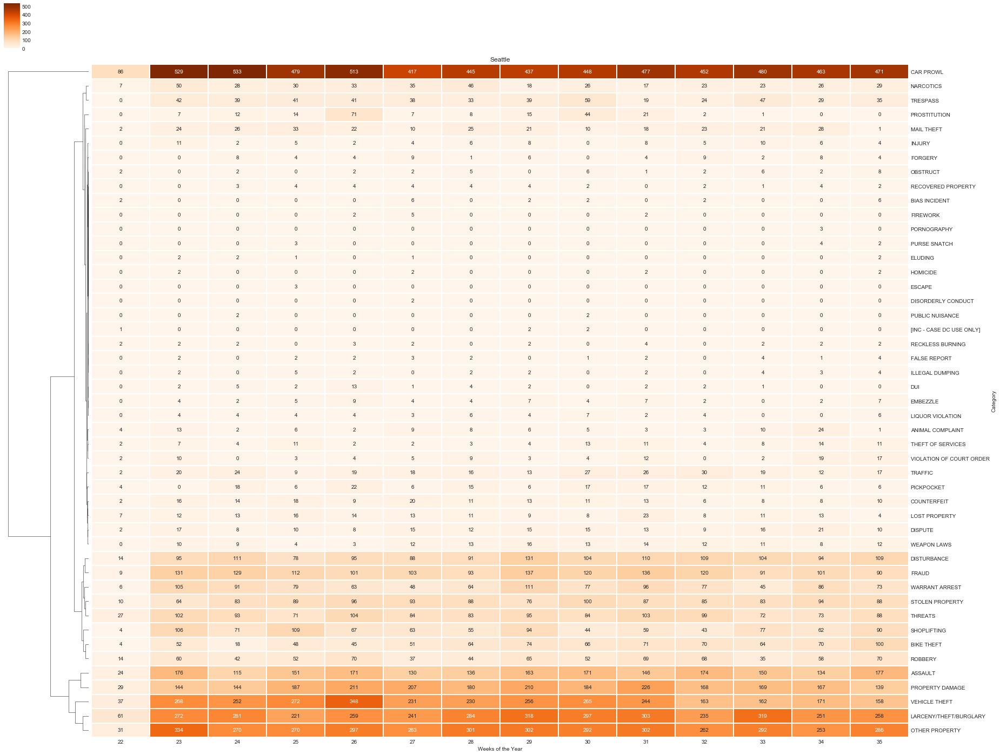

In [46]:
sfo_cat_week_df=sfo[['category','week']].copy()
sfo_cat_week_df['count'] = 1
sfo_cat_week_grp = sfo_cat_week_df.groupby(['category','week']).count()

sfo_cat_week_grp = sfo_cat_week_grp.reset_index()

sfo_cat_week_pvt = sfo_cat_week_grp.pivot('category','week','count').fillna(0).astype(int)

g = sns.clustermap(sfo_cat_week_pvt, cmap='Oranges',figsize=(30,25),
               annot=True,fmt='d',col_cluster=False,linewidth='1',linecolor='white')

g.ax_heatmap.set(title='San Francisco')
g.ax_heatmap.set_xlabel("Weeks of the Year")
g.ax_heatmap.set_ylabel("Category")


stl_cat_week_df=stl[['category','week']].copy()
stl_cat_week_df['count'] = 1
stl_cat_week_grp = stl_cat_week_df.groupby(['category','week']).count()

stl_cat_week_grp = stl_cat_week_grp.reset_index()

stl_cat_week_pvt = stl_cat_week_grp.pivot('category','week','count').fillna(0).astype(int)


g = sns.clustermap(stl_cat_week_pvt, cmap='Oranges',figsize=(30,25),
               annot=True,fmt='d',col_cluster=False,linewidth='1',linecolor='white')

g.ax_heatmap.set(title='Seattle')
g.ax_heatmap.set_xlabel("Weeks of the Year")
g.ax_heatmap.set_ylabel("Category")


Also, for both San Francisco and Seattle, we can see that 'Car Prowl' tops all the categories for most of the districts too.

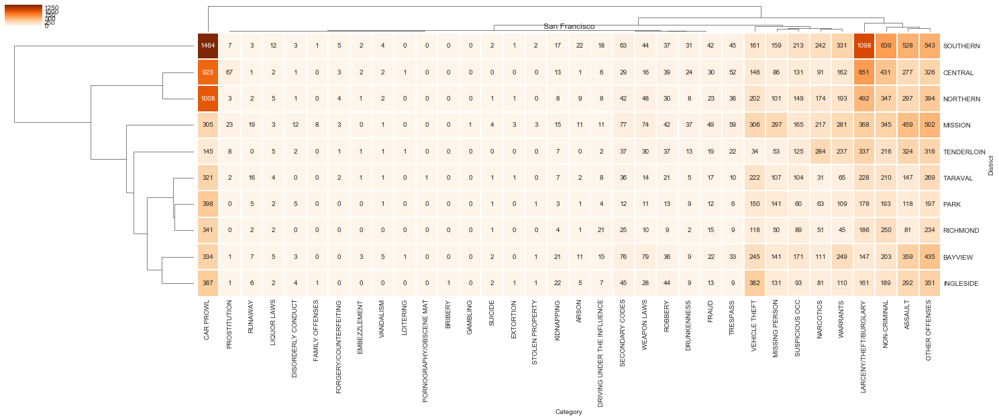

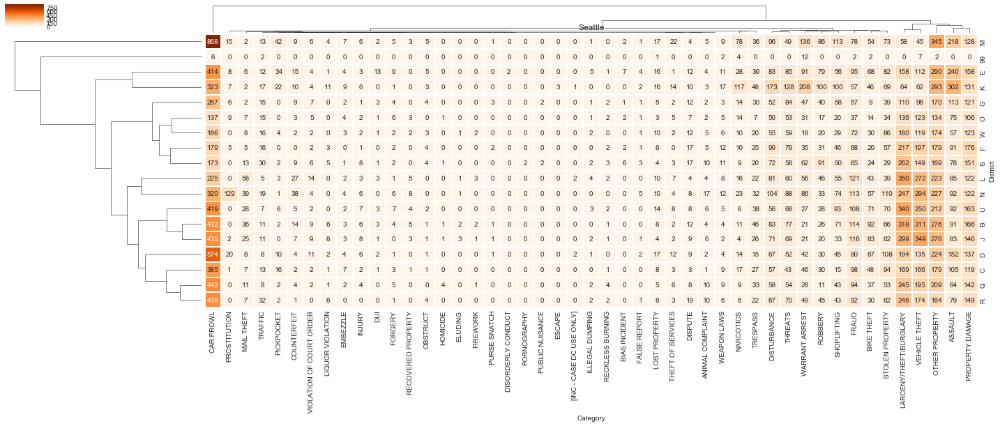

In [47]:
sfo_dist_cat_df=sfo[['district','category']].copy()
sfo_dist_cat_df['count'] = 1
sfo_dist_cat_grp = sfo_dist_cat_df.groupby(['district','category']).count()

sfo_dist_cat_grp = sfo_dist_cat_grp.reset_index()

sfo_dist_cat_pvt = sfo_dist_cat_grp.pivot('district','category','count').fillna(0).astype(int)


g = sns.clustermap(sfo_dist_cat_pvt,cmap='Oranges', figsize=(25,8),
               linewidth='1',linecolor='white',annot=True, fmt='d')
g.ax_heatmap.set(title='San Francisco') 
g.ax_heatmap.set_xlabel("Category")
g.ax_heatmap.set_ylabel("District")

stl_dist_cat_df=stl[['district','category']].copy()
stl_dist_cat_df['count'] = 1
stl_dist_cat_grp = stl_dist_cat_df.groupby(['district','category']).count()

stl_dist_cat_grp = stl_dist_cat_grp.reset_index()

stl_dist_cat_pvt = stl_dist_cat_grp.pivot('district','category','count').fillna(0).astype(int)

g = sns.clustermap(stl_dist_cat_pvt,cmap='Oranges', figsize=(25,8),
               linewidth='1',linecolor='white',annot=True, fmt='d')
g.ax_heatmap.set(title='Seattle') 
g.ax_heatmap.set_xlabel("Category")
g.ax_heatmap.set_ylabel("District")

## Conclusion <a class="anchor" id="con"></a>

From the above analysis, it is evident that Car Prowling was high prevalent than other crime incidents by a large margin in both San Francisco and Seattle. Furthermore, this high trend was observed for every week of the summer and on majority of the districts as well, in both the cities. 

Between San Francisco and Seattle, the latter had been the bigger victim of Car Prowling incidents during this period, though not by a huge margin.